Cambia la directory di lavoro corrente alla cartella specifica per questo laboratorio.

In [43]:
%cd ~/src/laboratori/0910

/home/jovyan/src/laboratori/0910


# **Introduzione al Machine Learning -- laboratorio 9 e 10**

Importa le librerie necessarie (pandas, numpy, matplotlib, seaborn). Legge il file Excel 'body.xlsx' in un DataFrame pandas, impostando la prima colonna come indice. Visualizza le prime righe del DataFrame.

In [44]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_excel('body.xlsx', index_col=0)
df.head()

,Biacromial diameter (see Fig. 2),"Biiliac diameter, or ""pelvic breadth"" (see Fig. 2)",Bitrochanteric diameter (see Fig. 2),"Chest depth between spine and sternum at nipple level,","Chest diameter at nipple level, mid-expiration","Elbow diameter, sum of two elbows","Wrist diameter, sum of two wrists","Knee diameter, sum of two knees","Ankle diameter, sum of two ankles",Shoulder girth over deltoid muscles,...,"Bicep girth, flexed, average of right and left girths","Forearm girth, extended, palm up, average of right and","Knee girth over patella, slightly flexed position, average","Calf maximum girth, average of right and left girths","Ankle minimum girth, average of right and left girths","Wrist minimum girth, average of right and left girths",Age (years),Weight (kg),Height (cm),"Gender (1 - male, 0 - female)"
Id,,,,,,,,,,,,,,,,,,,,,
1,42.9,26.0,31.5,17.7,28.0,13.1,10.4,18.8,14.1,106.2,...,32.5,26.0,34.5,36.5,23.5,16.5,21,65.6,174.0,1
2,43.7,28.5,33.5,16.9,30.8,14.0,11.8,20.6,15.1,110.5,...,34.4,28.0,36.5,37.5,24.5,17.0,23,71.8,175.3,1
3,40.1,28.2,33.3,20.9,31.7,13.9,10.9,19.7,14.1,115.1,...,33.4,28.8,37.0,37.3,21.9,16.9,28,80.7,193.5,1
4,44.3,29.9,34.0,18.4,28.2,13.9,11.2,20.9,15.0,104.5,...,31.0,26.2,37.0,34.8,23.0,16.6,23,72.6,186.5,1
5,42.5,29.9,34.0,21.5,29.4,15.2,11.6,20.7,14.9,107.5,...,32.0,28.4,37.7,38.6,24.4,18.0,22,78.8,187.2,1


Definisce una lista di nomi abbreviati per le colonne del DataFrame.

In [45]:
short_names = ['Biacromial',
'Biiliac',
'Bitrochanteric',
'Chest_depth',
'Chest_diameter',
'Elbow',
'Wrist_diameter',
'Knee_diameter',
'Ankle_diameter',
'Shoulder',
'Chest_girth',
'Waist',
'Navel',
'Hip',
'Thigh',
'Bicep',
'Forearm_girth',
'Knee_girth',
'Calf',
'Ankle_minimum',
'Wrist_minimum',
'Age',
'Weight',
'Height',
'Gender']

Assegna la lista di nomi abbreviati `short_names` come nuovi nomi delle colonne del DataFrame `df` e visualizza il DataFrame aggiornato.

In [46]:
df.columns = short_names
df

,Biacromial,Biiliac,Bitrochanteric,Chest_depth,Chest_diameter,Elbow,Wrist_diameter,Knee_diameter,Ankle_diameter,Shoulder,...,Bicep,Forearm_girth,Knee_girth,Calf,Ankle_minimum,Wrist_minimum,Age,Weight,Height,Gender
Id,,,,,,,,,,,,,,,,,,,,,
1,42.9,26.0,31.5,17.7,28.0,13.1,10.4,18.8,14.1,106.2,...,32.5,26.0,34.5,36.5,23.5,16.5,21,65.6,174.0,1
2,43.7,28.5,33.5,16.9,30.8,14.0,11.8,20.6,15.1,110.5,...,34.4,28.0,36.5,37.5,24.5,17.0,23,71.8,175.3,1
3,40.1,28.2,33.3,20.9,31.7,13.9,10.9,19.7,14.1,115.1,...,33.4,28.8,37.0,37.3,21.9,16.9,28,80.7,193.5,1
4,44.3,29.9,34.0,18.4,28.2,13.9,11.2,20.9,15.0,104.5,...,31.0,26.2,37.0,34.8,23.0,16.6,23,72.6,186.5,1
5,42.5,29.9,34.0,21.5,29.4,15.2,11.6,20.7,14.9,107.5,...,32.0,28.4,37.7,38.6,24.4,18.0,22,78.8,187.2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503,38.0,30.4,32.9,17.0,27.1,12.9,10.4,19.5,14.4,108.4,...,30.3,25.4,37.7,37.9,22.4,15.4,29,71.8,176.5,0
504,35.3,28.7,30.4,17.7,25.6,12.4,9.8,17.3,13.6,99.3,...,30.1,23.6,35.6,33.3,22.4,15.2,21,55.5,164.4,0
505,34.7,24.9,24.7,17.3,24.2,12.0,10.2,18.0,13.6,91.9,...,27.4,24.0,34.4,34.1,21.2,15.5,33,48.6,160.7,0


Genera una matrice di scatter plot (`pairplot`) utilizzando seaborn per visualizzare le relazioni a coppie tra le variabili nel DataFrame `df`. I punti sono colorati in base alla colonna 'Gender'. Salva il grafico come file PDF e lo visualizza.

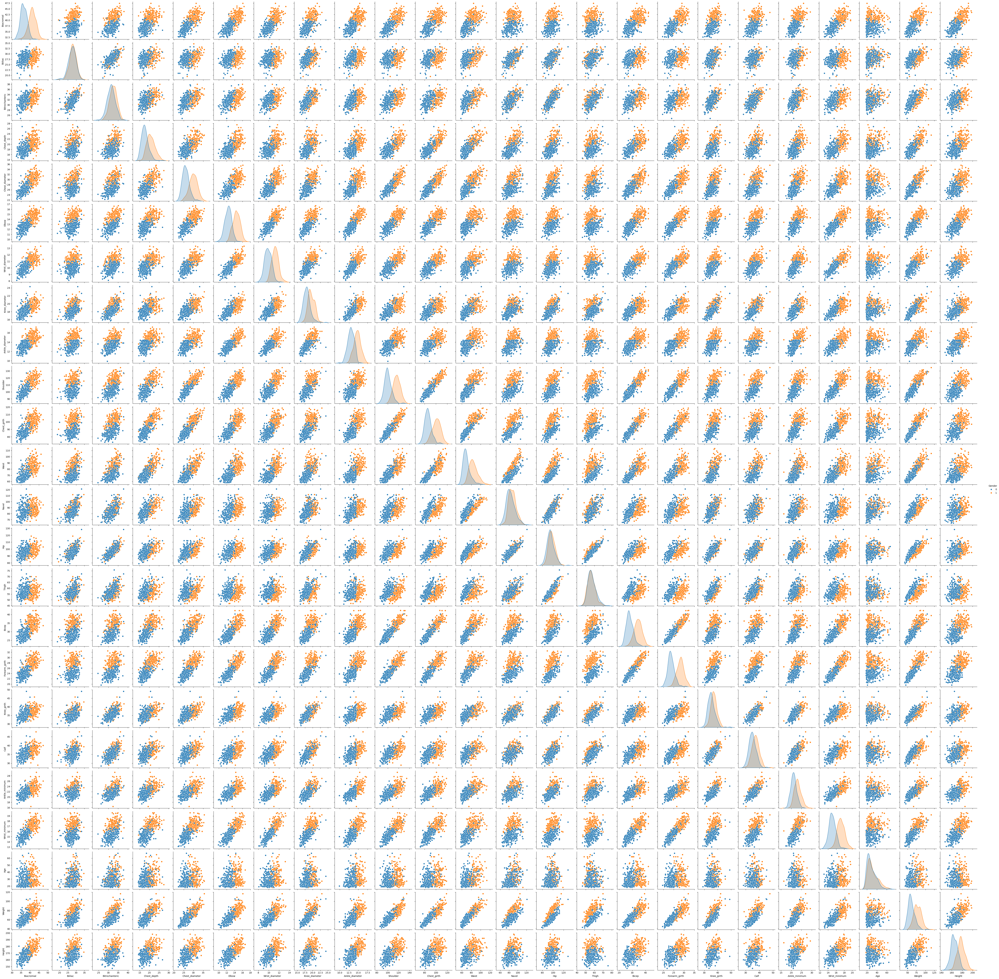

In [47]:
pair_plot = sns.pairplot(df, hue='Gender')
pair_plot.savefig('images/pairplot.pdf')
pair_plot

Facciamo la PCA di questo dataset, prima con scikit-learn, poi a mano, poi controlliamo gli altri metodi.

Importa la classe `PCA` da `sklearn.decomposition`. Inizializza un oggetto `PCA` per ridurre la dimensionalità a 2 componenti. Applica la PCA al DataFrame `df` (escludendo la colonna 'Gender') usando `fit_transform` e memorizza le componenti principali risultanti.

In [48]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
principal_components = pca.fit_transform(df.drop('Gender', axis=1))

Mostra le dimensioni (forma) dell'array `principal_components` risultante dalla PCA.

In [49]:
principal_components.shape

(507, 2)

Crea uno scatter plot delle prime due componenti principali. I punti sono colorati in base ai valori della colonna 'Gender' del DataFrame originale.

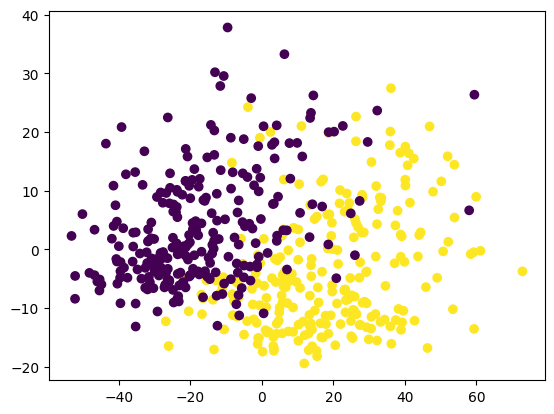

In [50]:
plt.scatter(principal_components[:, 0], principal_components[:, 1], c=df['Gender'])
plt.show()

Ora la facciamo a mano perche si capisce poco

Estrae i valori numerici dal DataFrame `df` (escludendo la colonna 'Gender') e li memorizza in un array NumPy `X`. Visualizza l'array `X`.

In [51]:
X = df.drop('Gender', axis=1).values
X

array([[ 42.9,  26. ,  31.5, ...,  21. ,  65.6, 174. ],
       [ 43.7,  28.5,  33.5, ...,  23. ,  71.8, 175.3],
       [ 40.1,  28.2,  33.3, ...,  28. ,  80.7, 193.5],
       ...,
       [ 34.7,  24.9,  24.7, ...,  33. ,  48.6, 160.7],
       [ 38.5,  29. ,  32.9, ...,  33. ,  66.4, 174. ],
       [ 35.6,  29. ,  29. , ...,  38. ,  67.3, 163.8]])

Calcola e visualizza la media di ciascuna colonna (feature) dell'array `X`.

In [52]:
X.mean(axis=0)

array([ 38.81143984,  27.82998028,  31.98047337,  19.2260355 ,
        27.97376726,  13.3852071 ,  10.54260355,  18.81065089,
        13.86331361, 108.19506903,  93.33353057,  76.97948718,
        85.65384615,  96.68086785,  56.85581854,  31.16962525,
        25.94299803,  36.20295858,  36.07830375,  22.15739645,
        16.0974359 ,  30.18145957,  69.14753452, 171.14378698])

Centra i dati sottraendo la media di ciascuna colonna dai rispettivi valori. Memorizza i dati centrati in `X_centered` e li visualizza.

In [53]:
X_centered = X - X.mean(axis=0)
X_centered

array([[  4.08856016,  -1.82998028,  -0.48047337, ...,  -9.18145957,
         -3.54753452,   2.85621302],
       [  4.88856016,   0.67001972,   1.51952663, ...,  -7.18145957,
          2.65246548,   4.15621302],
       [  1.28856016,   0.37001972,   1.31952663, ...,  -2.18145957,
         11.55246548,  22.35621302],
       ...,
       [ -4.11143984,  -2.92998028,  -7.28047337, ...,   2.81854043,
        -20.54753452, -10.44378698],
       [ -0.31143984,   1.17001972,   0.91952663, ...,   2.81854043,
         -2.74753452,   2.85621302],
       [ -3.21143984,   1.17001972,  -2.98047337, ...,   7.81854043,
         -1.84753452,  -7.34378698]])

Calcola la deviazione standard di ciascuna colonna dell'array originale `X`. Crea un grafico a punti di queste deviazioni standard, impostando i limiti dell'asse y e mostrando il grafico.

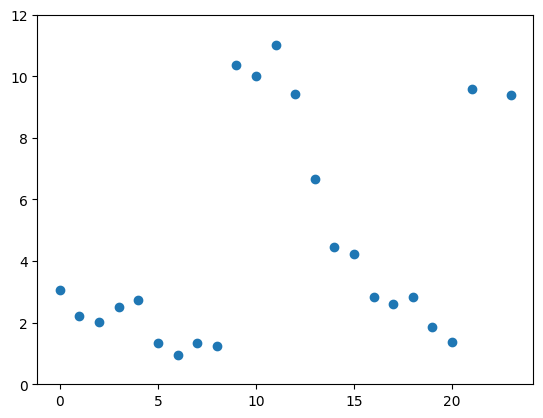

In [54]:
plt.plot(X.std(axis=0), 'o')
plt.ylim([0, 12])
plt.show()

Abbiamo scale differenti, conviene fare il caso 2 della PCA (i.e., standardizzo prima di ruotare)

Standardizza i dati centrati `X_centered` dividendo ciascuna colonna per la sua deviazione standard campionaria (usando `ddof=1`). Memorizza i dati standardizzati in `X_std` e li visualizza.

In [55]:
X_std = X_centered / X_centered.std(axis=0, ddof=1)
X_std

array([[ 1.33650994, -0.82943101, -0.23657969, ..., -0.95555873,
        -0.2658173 ,  0.30361972],
       [ 1.59802204,  0.30368367,  0.74819784, ..., -0.7474091 ,
         0.19874964,  0.44181167],
       [ 0.42121759,  0.16770991,  0.64972009, ..., -0.22703501,
         0.86562798,  2.37649892],
       ...,
       [-1.34398908, -1.32800146, -3.5848233 , ...,  0.29333908,
        -1.53962987, -1.1101902 ],
       [-0.10180661,  0.53030661,  0.45276458, ...,  0.29333908,
        -0.20587318,  0.30361972],
       [-1.04978797,  0.53030661, -1.46755161, ...,  0.81371317,
        -0.13843604, -0.78065555]])

Calcola la matrice di covarianza dei dati standardizzati trasposti (`X_std.T`) usando `np.cov`. Stampa le dimensioni della matrice di covarianza `sigma` e visualizza le prime 5 righe e colonne.

In [56]:
sigma = np.cov(X_std.T)
print(sigma.shape)
sigma[0:5, 0:5]

(24, 24)


array([[1.        , 0.30903585, 0.48627257, 0.58325846, 0.7691406 ],
       [0.30903585, 1.        , 0.67345673, 0.35678521, 0.33116948],
       [0.48627257, 0.67345673, 1.        , 0.47255604, 0.52412881],
       [0.58325846, 0.35678521, 0.47255604, 1.        , 0.66507019],
       [0.7691406 , 0.33116948, 0.52412881, 0.66507019, 1.        ]])

Calcola la matrice di correlazione dei dati standardizzati trasposti (`X_std.T`) usando `np.corrcoef` e visualizza le prime 5 righe e colonne. Nota: per dati standardizzati, la matrice di covarianza è uguale alla matrice di correlazione.

In [57]:
# Posso anche usare questo metodo
np.corrcoef(X_std.T)[0:5, 0:5]

array([[1.        , 0.30903585, 0.48627257, 0.58325846, 0.7691406 ],
       [0.30903585, 1.        , 0.67345673, 0.35678521, 0.33116948],
       [0.48627257, 0.67345673, 1.        , 0.47255604, 0.52412881],
       [0.58325846, 0.35678521, 0.47255604, 1.        , 0.66507019],
       [0.7691406 , 0.33116948, 0.52412881, 0.66507019, 1.        ]])

La matrice di covarianza campionaria si trova semplicemente così:
$$
\frac{1}{n-1}X^TX
$$
dove $X$ è la matrice dei dati *centrata*.
Se $X$ è anche standardizzata, ovviamente viene la matrice di correlazione.

Calcola la matrice di covarianza (o correlazione, essendo i dati standardizzati) manualmente usando la formula $\frac{1}{n-1}X_{std}^T X_{std}$. Visualizza le prime 5 righe e colonne del risultato per verificare che coincida con i metodi precedenti.

In [58]:
# Ma anche in quest'altro modo
(X_std.T @ X_std / (X_std.shape[0] - 1))[0:5, 0:5]

array([[1.        , 0.30903585, 0.48627257, 0.58325846, 0.7691406 ],
       [0.30903585, 1.        , 0.67345673, 0.35678521, 0.33116948],
       [0.48627257, 0.67345673, 1.        , 0.47255604, 0.52412881],
       [0.58325846, 0.35678521, 0.47255604, 1.        , 0.66507019],
       [0.7691406 , 0.33116948, 0.52412881, 0.66507019, 1.        ]])

Visualizza la matrice di covarianza `sigma` come un'immagine (heatmap) usando `plt.imshow`. Aggiunge una barra dei colori per riferimento.

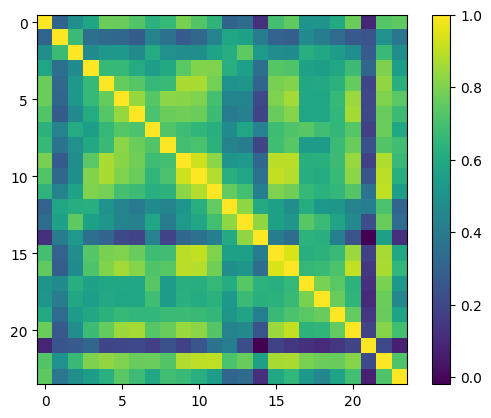

In [59]:
plt.imshow(sigma)
plt.colorbar()
plt.show()

Adesso costruiamo le matrici di autovettori e autovalori

Calcola gli autovalori (`lambdaa`) e gli autovettori (`V`) della matrice di covarianza `sigma` usando `np.linalg.eig`. Stampa le dimensioni degli array risultanti.

In [60]:
lambdaa, V = np.linalg.eig(sigma)
print(lambdaa.shape)
print(V.shape)

(24,)
(24, 24)


Crea un grafico a punti degli autovalori calcolati (`lambdaa`) per visualizzarne la distribuzione.

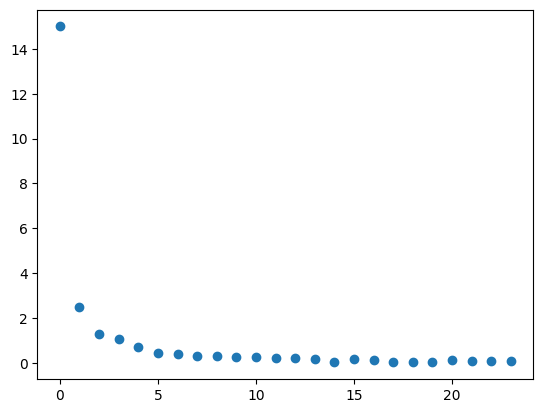

In [61]:
plt.plot(lambdaa, 'o')
plt.show()

Crea un altro grafico a punti degli autovalori, ma con un limite sull'asse y per osservare meglio i valori più piccoli. 

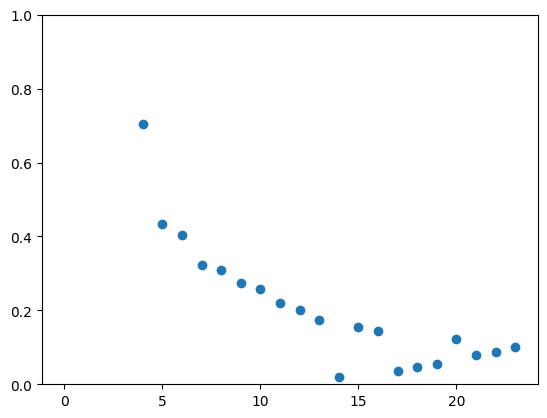

In [62]:
# Sono quasi ordinate ma non perfettamente

plt.plot(lambdaa, 'o')
plt.ylim([0, 1])
plt.show()

# Anzi, non sono proprio ordinate...

Visualizza la matrice degli autovettori `V` come un'immagine per capire se gli autovettori sono disposti per riga o per colonna.

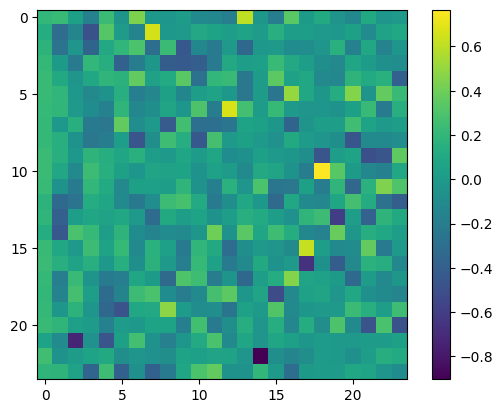

In [63]:
# Come sono ordinati questi autovettori? In verticale o in orizzontale?
plt.imshow(V)
plt.colorbar()
plt.show()
# In verticale, perche la prima colonna e' uniforme piatta

Estrae e visualizza il primo autovettore (prima colonna della matrice `V`).

In [64]:
V[:, 0]

array([0.20196704, 0.12803044, 0.17802782, 0.20652474, 0.22214303,
       0.22416606, 0.21543726, 0.21121735, 0.20658455, 0.23347484,
       0.23588027, 0.22877507, 0.17713957, 0.1862599 , 0.12803506,
       0.23120582, 0.23516234, 0.20582333, 0.20111592, 0.20856532,
       0.22854459, 0.06717652, 0.25120421, 0.18788607])

Estrae e visualizza il secondo autovettore (seconda colonna della matrice `V`).

In [65]:
V[:, 1]

array([ 0.2314016 , -0.30908438, -0.26618219,  0.00382111,  0.11178659,
        0.19391767,  0.19776532, -0.01116627,  0.15061879,  0.14659489,
        0.09426943, -0.04813837, -0.33259683, -0.39142444, -0.44109675,
        0.09830892,  0.15125143, -0.19235414, -0.15754455, -0.01736926,
        0.1897616 , -0.09748719, -0.04939425,  0.18525534])

Proietta i dati standardizzati `X_std` sullo spazio degli autovettori moltiplicando `X_std` per la matrice degli autovettori `V`. Memorizza il risultato (le componenti principali calcolate manualmente) in `pca` e ne visualizza le dimensioni.

In [66]:
pca = X_std @ V
pca.shape

(507, 24)

Crea uno scatter plot delle prime due componenti principali calcolate manualmente (`pca[:, 0]` e `pca[:, 1]`). I punti sono colorati in base alla colonna 'Gender'.

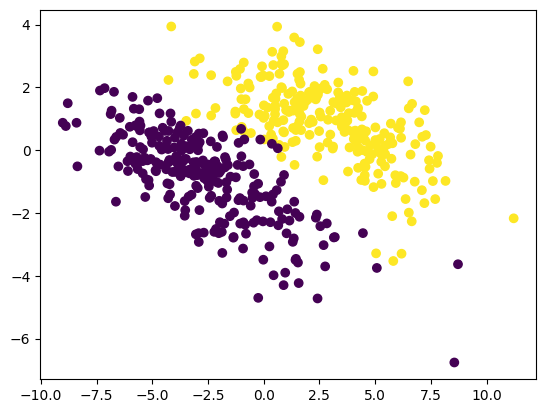

In [67]:
plt.scatter(pca[:, 0], pca[:, 1], c=df['Gender'])
plt.show()

Spiegazione vari metodi e relazione autovalori e SVD

https://chatgpt.com/share/67da897a-ee84-800c-9414-9ebc2d797989

Esegue la Decomposizione ai Valori Singolari (SVD) sui dati standardizzati `X_std` usando `np.linalg.svd`. Memorizza le matrici U, S (valori singolari) e Vt. Stampa le dimensioni di queste matrici.

In [68]:
# Proviamo con la SVD
U, S, Vt = np.linalg.svd(X_std, full_matrices=False)
U.shape, S.shape, Vt.shape

((507, 24), (24,), (24, 24))

Crea un grafico a punti dei valori singolari `S` ottenuti dalla SVD.

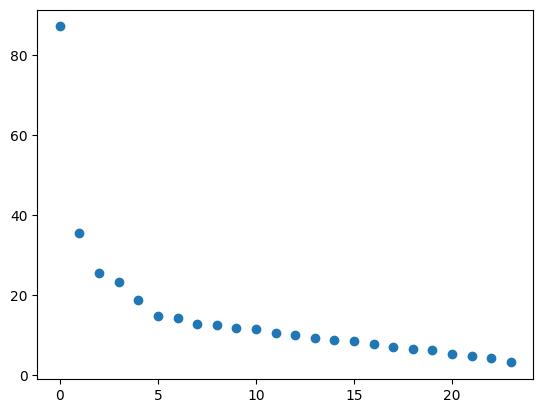

In [69]:
plt.plot(S, 'o')
plt.show()

Crea un grafico dei quadrati dei valori singolari `S` divisi per (n-1) (qui approssimato a 506, che è n). Questo mostra la relazione tra i valori singolari e gli autovalori della matrice di covarianza ($\lambda = \frac{S^2}{n-1}$).

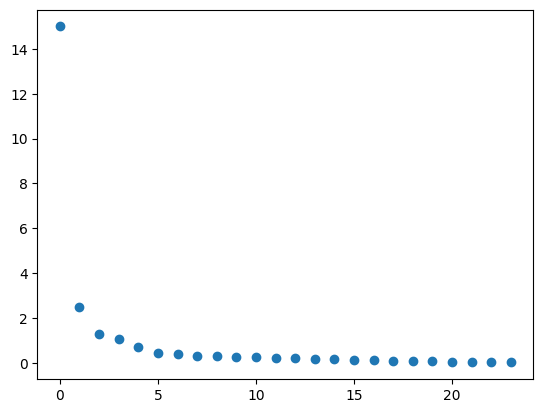

In [70]:
plt.plot(S**2/506, 'o')
plt.show()

Crea un grafico dei valori singolari `S` divisi per la radice quadrata di (n-1) (approssimato a sqrt(506)). Questo grafico (scree plot) aiuta a determinare quante componenti principali conservare. 

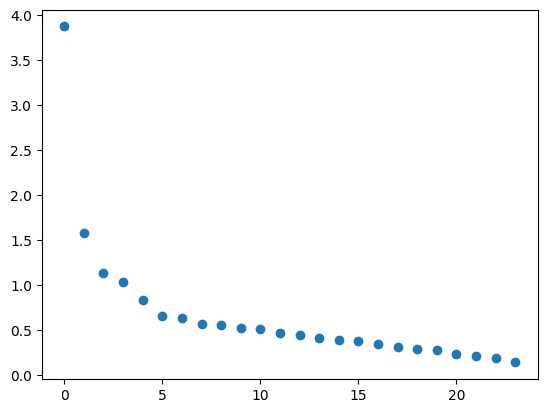

In [71]:
plt.plot(S/np.sqrt(506), 'o')
plt.show()

# Da questo grafico, conviene tenere le prime 5 componenti al massimo

Visualizza la matrice `Vt` (trasposta degli autovettori destri, che corrispondono alle direzioni principali) come un'immagine.

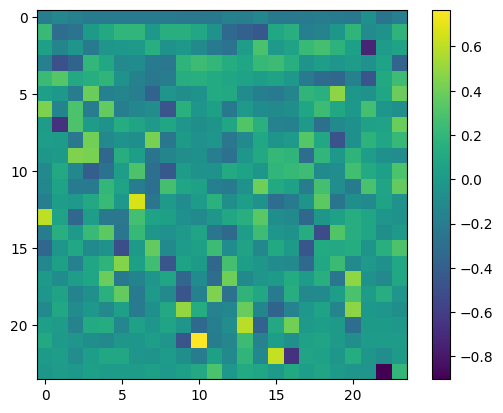

In [72]:
plt.imshow(Vt)
plt.colorbar()
plt.show()

Calcola le componenti principali proiettando i dati standardizzati `X_std` sulla base data dalle righe di `Vt` (cioè moltiplicando per `Vt.T`). Memorizza il risultato in `pca_svd` e ne visualizza le dimensioni.

In [73]:
pca_svd = X_std @ Vt.T
pca_svd.shape

(507, 24)

Crea uno scatter plot delle prime due componenti principali ottenute tramite SVD (`pca_svd[:, 0]` e `pca_svd[:, 1]`). I punti sono colorati in base alla colonna 'Gender'.

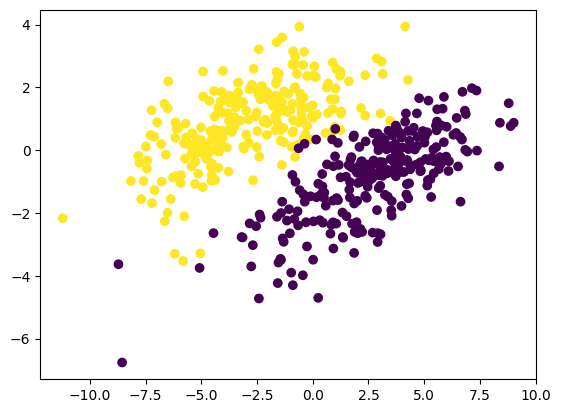

In [74]:
plt.scatter(pca_svd[:, 0], pca_svd[:, 1], c=df['Gender'])
plt.show()

Visualizza la prima riga di `Vt` (la prima direzione principale). La direzione potrebbe essere opposta rispetto al metodo basato su `eig` (il segno degli autovettori/direzioni principali è arbitrario).

In [75]:
Vt[0] # Per caso la direzione è venuta opposta

array([-0.20196704, -0.12803044, -0.17802782, -0.20652474, -0.22214303,
       -0.22416606, -0.21543726, -0.21121735, -0.20658455, -0.23347484,
       -0.23588027, -0.22877507, -0.17713957, -0.1862599 , -0.12803506,
       -0.23120582, -0.23516234, -0.20582333, -0.20111592, -0.20856532,
       -0.22854459, -0.06717652, -0.25120421, -0.18788607])

Crea uno scatter plot della seconda e terza componente principale ottenute tramite SVD (`pca_svd[:, 1]` e `pca_svd[:, 2]`). I punti sono colorati in base alla colonna 'Gender'.

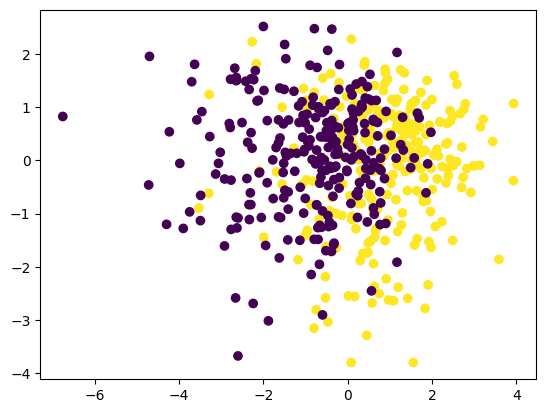

In [76]:
plt.scatter(pca_svd[:, 1], pca_svd[:, 2], c=df['Gender'])
plt.show()

Iniziamo il discorso sugli stimatori di massima verosimiglianza.

Importa la distribuzione esponenziale da `scipy.stats`. Genera un campione casuale `sample` di dimensione `n=50` da una distribuzione esponenziale con media `mean=3.5`. Visualizza i punti del campione generato.

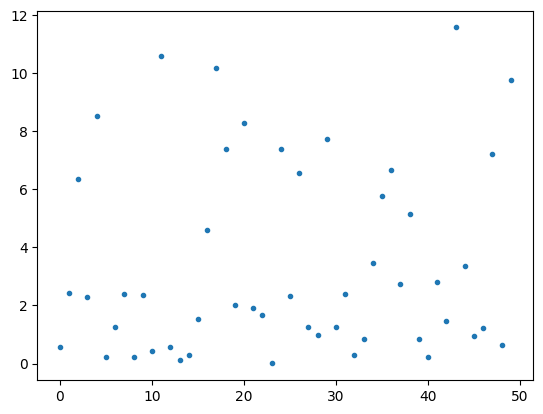

In [77]:
# Generiamo un campione con legge esponenziale assegnata e calcoliamo la likelihood.

from scipy.stats import expon

n = 50
mean = 3.5

sample = expon.rvs(scale=mean, size=n)
plt.plot(sample, '.')
plt.show()

Definisce una funzione `log_likelihood(mu)` che calcola la log-verosimiglianza del campione `sample` per una data media `mu`, assumendo una distribuzione esponenziale. Crea un range di possibili valori per `mu` e traccia il grafico della log-verosimiglianza in funzione di `mu`.

/opt/conda/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:2029: RuntimeWarning: divide by zero encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


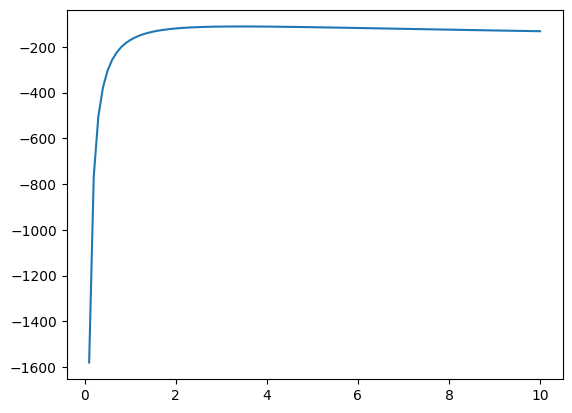

In [78]:
# Calcoliamo la log-likelihood

def log_likelihood(mu):
  return expon.logpdf(sample, scale=mu).sum()

mu_range = np.linspace(0, 10, 100)
plt.plot(mu_range, [log_likelihood(mu) for mu in mu_range])
plt.show()

Traccia nuovamente il grafico della log-verosimiglianza. Aggiunge un punto rosso in corrispondenza della media campionaria (`sample.mean()`) e del valore della log-verosimiglianza calcolato in quel punto. Questo illustra che la media campionaria è lo stimatore di massima verosimiglianza per il parametro di scala (media) della distribuzione esponenziale. Imposta i limiti dell'asse y per una migliore visualizzazione.

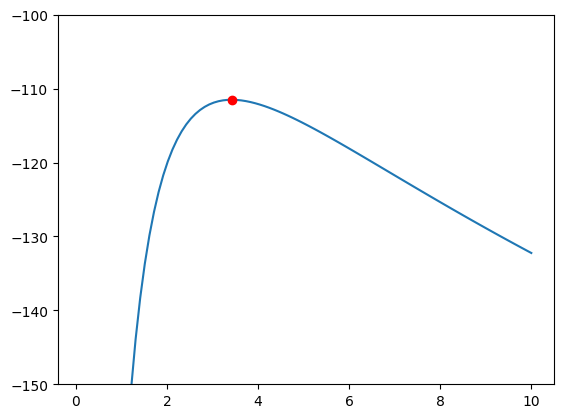

In [79]:
plt.plot(mu_range, [log_likelihood(mu) for mu in mu_range])
plt.plot(sample.mean(), log_likelihood(sample.mean()), 'or') # La media corrisponde allo stimatore di massimo somiglianza
plt.ylim([-150, -100])
plt.show()